# Training and Evaluating a Perceptron Model


In [13]:
import sklearn
import tensorflow as tf
import numpy as np


%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [17]:
import pandas as pd

In [19]:
data=pd.read_csv('https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv')

In [21]:
from sklearn.linear_model import Perceptron

In [27]:
# Prepare the features and target
# Assuming 'loyalty' is the target column and rest are features
X = data.drop(columns=['Loyalty'])  # Features (drop the target column)
y = data['Loyalty']  # Target: loyalty column

In [29]:
from sklearn.linear_model import Perceptron
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [31]:
# Split the data into training and test sets (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize and train the Perceptron model
model = Perceptron(max_iter=1000, random_state=42) #creates a perceptron object #max_iter=1000: Sets the maximum number of iterations the model can run for training and random_state=42: Ensures reproducibility by fixing the randomness during model initialization..
random_state=42: Ensures reproducibility by fixing the randomness during model initialization.
model.fit(X_train, y_train)

Perceptron(random_state=42)

In [37]:
#Initialize and train the Perceptron model with specific parameters
model = Perceptron(
    eta0=1,                      # Initial learning rate
    penalty=None,                 # No regularization
    max_iter=1000,                # Maximum number of iterations
    random_state=42               # For reproducibility
)
model.fit(X_train, y_train)

Perceptron(eta0=1, random_state=42)

In [39]:
# Make predictions on the test set
y_pred = model.predict(X_test)

In [43]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Model accuracy: {accuracy * 100:.2f}%")  

# print some predictions for inspection
print("Predictions:", y_pred)

Model accuracy: 62.88%
Predictions: [3 3 3 ... 3 3 4]


In [45]:
print(y.unique())  # This will show the unique values in the loyalty column


[1 4 3 2]


In [49]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [51]:
# Confusion matrix (shows how many instances of each class are predicted correctly)
cm = confusion_matrix(y_test, y_pred)#y_test: The true labels from the test dataset,y_pred: The predicted labels from the model
print("Confusion Matrix:\n", cm) #confusion_matrix: A function that calculates how many instances are correctly or incorrectly classified for each class.

Confusion Matrix:
 [[  605   297  3255   516]
 [   15   270   352   397]
 [  108   200 14857   882]
 [  144   511  6640  6822]]


In [53]:
# Classification report (precision, recall, f1-score for each class)
print("\nClassification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

           1       0.69      0.13      0.22      4673
           2       0.21      0.26      0.23      1034
           3       0.59      0.93      0.72     16047
           4       0.79      0.48      0.60     14117

    accuracy                           0.63     35871
   macro avg       0.57      0.45      0.44     35871
weighted avg       0.67      0.63      0.59     35871



## PERCEPTRON with selected featured based on SMOTE

Model Accuracy: 0.68

Classification Report:
              precision    recall  f1-score   support

           1       0.76      0.51      0.61     15708
           2       0.57      0.95      0.71     16009
           3       0.72      0.79      0.75     15858
           4       0.84      0.46      0.60     15795

    accuracy                           0.68     63370
   macro avg       0.72      0.68      0.67     63370
weighted avg       0.72      0.68      0.67     63370


Confusion Matrix:
[[ 7975  4487  2886   360]
 [  624 15229    84    72]
 [  773  1533 12601   951]
 [ 1103  5347  2046  7299]]


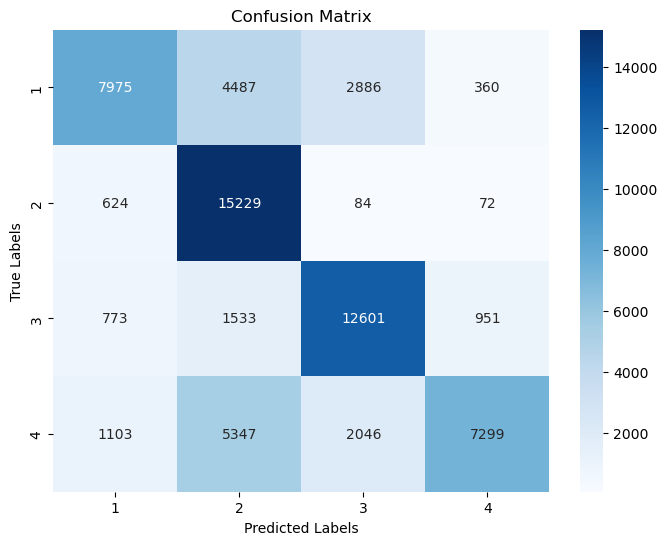

In [4]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Perceptron
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Load the data
url = "https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/feature_selected_data.csv"
data = pd.read_csv(url)

# Step 2: Prepare the features and target
# 'Loyalty' is the target column and rest are features
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Step 3: Split the data into training and test sets (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Step 4: Train the Perceptron model
model = Perceptron(max_iter=1000, random_state=42)
model.fit(X_train, y_train)

# Step 5: Make predictions
y_pred = model.predict(X_test)

# Step 6: Evaluate the model
# Accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Model Accuracy: {accuracy:.2f}")

# Classification Report
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("\nConfusion Matrix:")
print(conf_matrix)

# Visualize the Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=model.classes_, yticklabels=model.classes_)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()


### Training a Perceptron Model with Balanced Class Weights (Entire data )


In [55]:
# Step 5: Initialize and train the Perceptron model with class weights
from sklearn.linear_model import Perceptron

# Define the Perceptron model with balanced class weights
model = Perceptron(
    eta0=1,                     # Initial learning rate
    penalty=None,               # No regularization
    max_iter=1000,               # Maximum number of iterations
    random_state=42,             # For reproducibility
    class_weight='balanced'      # Automatically adjusts weights inversely proportional to class frequencies in the data, addressing class imbalance.
)

# Train the model
model.fit(X_train, y_train)

# Predict on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = (y_pred == y_test).mean()
print(f"Model accuracy: {accuracy * 100:.2f}%")

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)

# Classification report
from sklearn.metrics import classification_report
print("Classification Report:")
print(classification_report(y_test, y_pred))


Model accuracy: 59.65%
Confusion Matrix:
 [[  697  1644  1053  1279]
 [   11   926    23    74]
 [  167  3355  9222  3303]
 [  150  2666   748 10553]]
Classification Report:
              precision    recall  f1-score   support

           1       0.68      0.15      0.24      4673
           2       0.11      0.90      0.19      1034
           3       0.83      0.57      0.68     16047
           4       0.69      0.75      0.72     14117

    accuracy                           0.60     35871
   macro avg       0.58      0.59      0.46     35871
weighted avg       0.74      0.60      0.63     35871



### Training a Perceptron Model with Balanced Class Weights (Selected Features)


Model Accuracy: 48.00%
Confusion Matrix:
 [[13901  1621   174    12]
 [ 3458 12534     4    13]
 [11435  1159  3123   141]
 [13000  1829   109   857]]


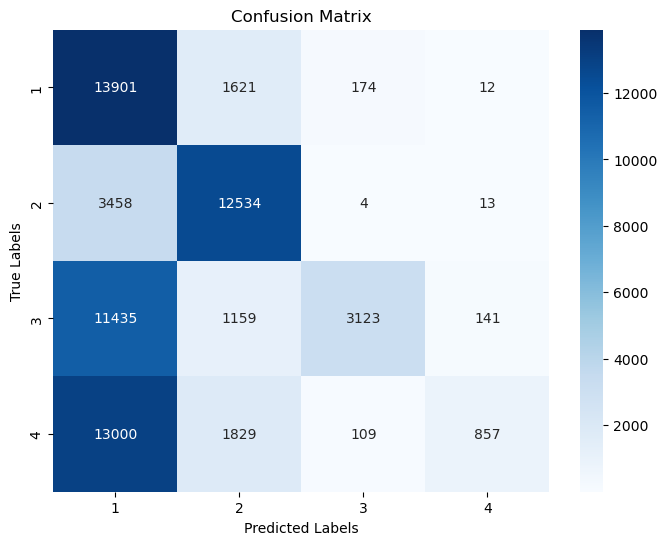

Classification Report:
              precision    recall  f1-score   support

           1       0.33      0.88      0.48     15708
           2       0.73      0.78      0.76     16009
           3       0.92      0.20      0.32     15858
           4       0.84      0.05      0.10     15795

    accuracy                           0.48     63370
   macro avg       0.70      0.48      0.42     63370
weighted avg       0.71      0.48      0.42     63370



In [2]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Perceptron
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Load the data
url = "https://github.com/HWhr3000/F21DL_Coursework_grp2/blob/main/data/feature_selected_data.csv?raw=true"
data = pd.read_csv(url)

# Step 2: Prepare the features and target
# 'Loyalty' is the target column and the rest are features
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Step 3: Split the data into training and test sets (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Step 4: Initialize and train the Perceptron model with balanced class weights
model = Perceptron(
    eta0=1,                     # Initial learning rate
    penalty=None,               # No regularization
    max_iter=1000,              # Maximum number of iterations
    random_state=42,            # For reproducibility
    class_weight='balanced'     # Adjusts weights inversely proportional to class frequencies
)

# Train the model
model.fit(X_train, y_train)

# Step 5: Make predictions
y_pred = model.predict(X_test)

# Step 6: Evaluate the model
# Accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)

# Visualize the Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=model.classes_, yticklabels=model.classes_)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

# Classification Report
print("Classification Report:")
print(classification_report(y_test, y_pred))


### Visualizing Decision Boundaries of a Perceptron Model with Selected Features


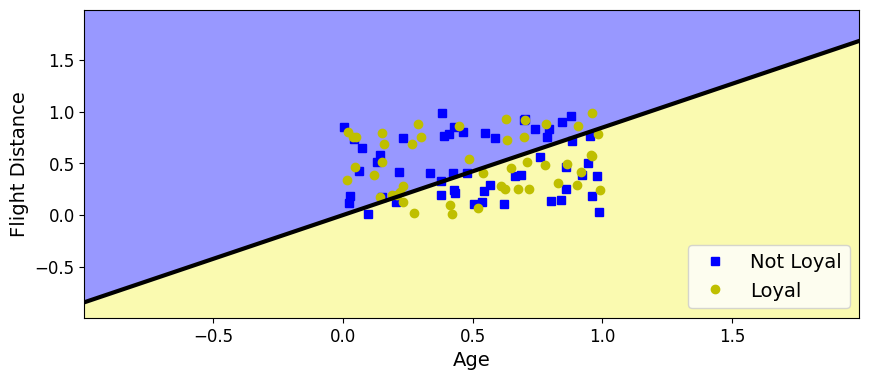

Accuracy on test set: 45.00%


In [59]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import Perceptron
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from matplotlib.colors import ListedColormap

# Assuming X has 21 features and y is the target variable 'Loyalty'

X = np.random.rand(100, 21)  # Example data with 21 features 
y = np.random.randint(0, 2, size=100)  # Example binary target

# Step 1: Select two features for visualization (e.g., 'Age' and 'Flight Distance')
# we can choose any two features here (indices for Age and Flight Distance are just for experiment)
selected_features = [1, 4]  # 'Age' and 'Flight Distance' 
X_selected = X[:, selected_features]

# Step 2: Standardize the selected features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_selected)

# Step 3: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Step 4: Initialize and train the Perceptron model
per_clf = Perceptron()
per_clf.fit(X_train, y_train)

# Step 5: Coefficients for the decision boundary equation (for 2D)
a = -per_clf.coef_[0][0] / per_clf.coef_[0][1]
b = -per_clf.intercept_ / per_clf.coef_[0][1]

# Step 6: Define the plotting range (axes for visualization)
axes = [X_selected[:, 0].min() - 1, X_selected[:, 0].max() + 1, X_selected[:, 1].min() - 1, X_selected[:, 1].max() + 1]

# Step 7: Create a mesh grid for visualization
x0, x1 = np.meshgrid(
    np.linspace(axes[0], axes[1], 500).reshape(-1, 1),
    np.linspace(axes[2], axes[3], 200).reshape(-1, 1),
)
X_new = np.c_[x0.ravel(), x1.ravel()]

# Step 8: Predict using the trained Perceptron model
y_predict = per_clf.predict(X_new)
zz = y_predict.reshape(x0.shape)

# Step 9: Plot the decision boundary and data points
plt.figure(figsize=(10, 4))

# Scatter plot of the points, assuming class 0 and class 1 for Loyalty
plt.plot(X_selected[y == 0, 0], X_selected[y == 0, 1], "bs", label="Not Loyal")
plt.plot(X_selected[y == 1, 0], X_selected[y == 1, 1], "yo", label="Loyal")

# Plot the decision boundary line
plt.plot([axes[0], axes[1]], [a * axes[0] + b, a * axes[1] + b], "k-", linewidth=3)

# Create a custom colormap
custom_cmap = ListedColormap(['#9898ff', '#fafab0'])

# Contour plot of decision regions
plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel("Age", fontsize=14)  # Replace with the correct feature name
plt.ylabel("Flight Distance", fontsize=14)  # Replace with the correct feature name
plt.legend(loc="lower right", fontsize=14)
plt.axis(axes)
plt.show()

# Evaluate the model accuracy on the test set
y_pred = per_clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy on test set: {accuracy * 100:.2f}%")


## One versus rest perceptron for entire data 

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Perceptron
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.multiclass import OneVsRestClassifier

# Step 1: Load the data
url = "https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv"
data = pd.read_csv(url)

# Step 2: Prepare the features and target
#'Loyalty' is the target column and the rest are features
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target


# Step 1: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Step 3: Initialize OneVsRestClassifier with Perceptron
model = OneVsRestClassifier(Perceptron(
    eta0=1,                     # Initial learning rate
    penalty=None,               # No regularization
    max_iter=1000,              # Maximum number of iterations
    random_state=42,            # For reproducibility
    class_weight='balanced'     # Automatically adjusts weights inversely proportional to class frequencies
))

# Step 4: Train the One-vs-All Perceptron model
model.fit(X_train, y_train)

# Step 5: Predict on the test set
y_pred = model.predict(X_test)

# Step 6: Evaluate the model's performance
accuracy = (y_pred == y_test).mean()  # Calculate accuracy
print(f"Model accuracy: {accuracy * 100:.2f}%")

# Step 7: Confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)

# Step 8: Classification report with zero_division parameter to handle warnings
print("Classification Report:")
print(classification_report(y_test, y_pred, zero_division=1))

Model accuracy: 71.10%
Confusion Matrix:
 [[1426  755  602  323]
 [  39  567   10   80]
 [ 891  427 8115 1275]
 [ 557 1291  661 6895]]
Classification Report:
              precision    recall  f1-score   support

           1       0.49      0.46      0.47      3106
           2       0.19      0.81      0.30       696
           3       0.86      0.76      0.81     10708
           4       0.80      0.73      0.77      9404

    accuracy                           0.71     23914
   macro avg       0.59      0.69      0.59     23914
weighted avg       0.77      0.71      0.73     23914



## One versus rest perceptron for features selected based on smote

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Perceptron
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.multiclass import OneVsRestClassifier

# Step 1: Load the data using the correct raw GitHub URL
url = "https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/feature_selected_data.csv"
data = pd.read_csv(url)

# Step 2: Prepare the features and target
# 'Loyalty' is the target column and the rest are features
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Step 3: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 4: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Step 5: Initialize OneVsRestClassifier with Perceptron
model = OneVsRestClassifier(Perceptron(
    eta0=1,                     # Initial learning rate
    penalty=None,               # No regularization
    max_iter=1000,              # Maximum number of iterations
    random_state=42,            # For reproducibility
    class_weight='balanced'     # Automatically adjusts weights inversely proportional to class frequencies
))

# Step 6: Train the One-vs-All Perceptron model
model.fit(X_train, y_train)

# Step 7: Predict on the test set
y_pred = model.predict(X_test)

# Step 8: Evaluate the model's performance
accuracy = (y_pred == y_test).mean()  # Calculate accuracy
print(f"Model accuracy: {accuracy * 100:.2f}%")

# Step 9: Confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)

# Step 10: Classification report with zero_division parameter to handle warnings
print("Classification Report:")
print(classification_report(y_test, y_pred, zero_division=1))



Model accuracy: 76.41%
Confusion Matrix:
 [[8644 1166  419  226]
 [ 559 9688  244  168]
 [1669  320 7709  863]
 [1356 2339  635 6242]]
Classification Report:
              precision    recall  f1-score   support

           1       0.71      0.83      0.76     10455
           2       0.72      0.91      0.80     10659
           3       0.86      0.73      0.79     10561
           4       0.83      0.59      0.69     10572

    accuracy                           0.76     42247
   macro avg       0.78      0.76      0.76     42247
weighted avg       0.78      0.76      0.76     42247



## Perceptron decision boundary for all features

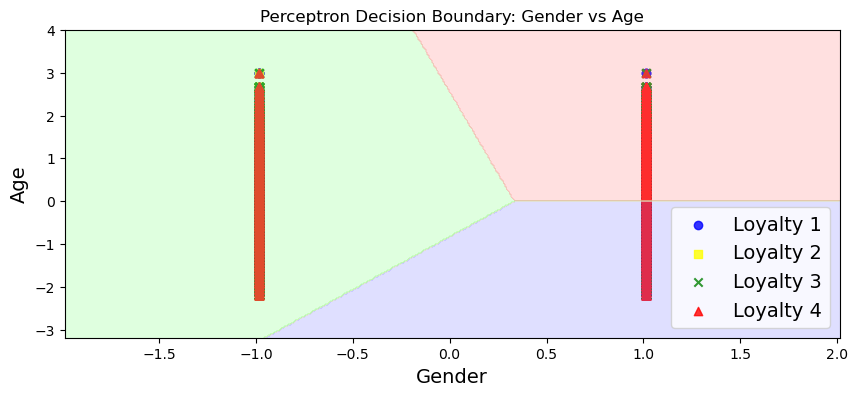

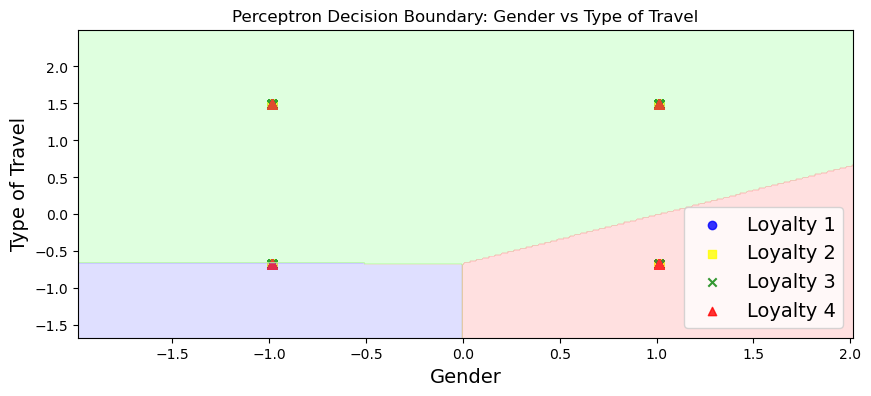

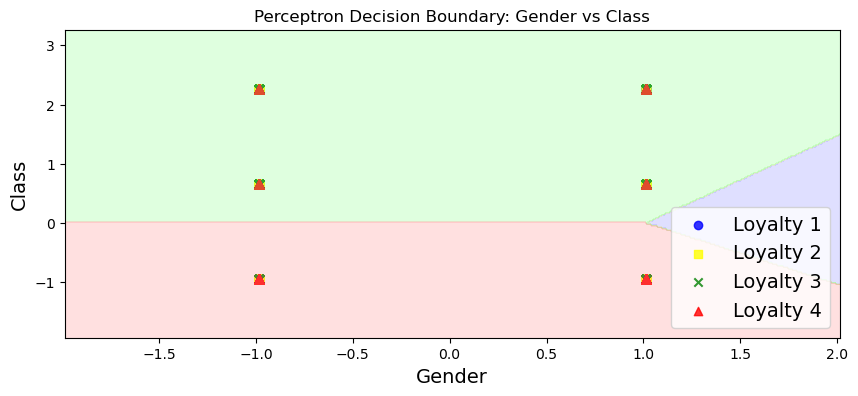

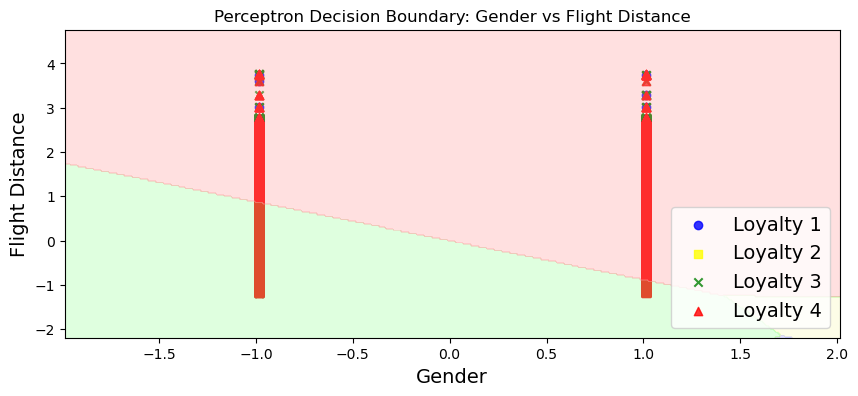

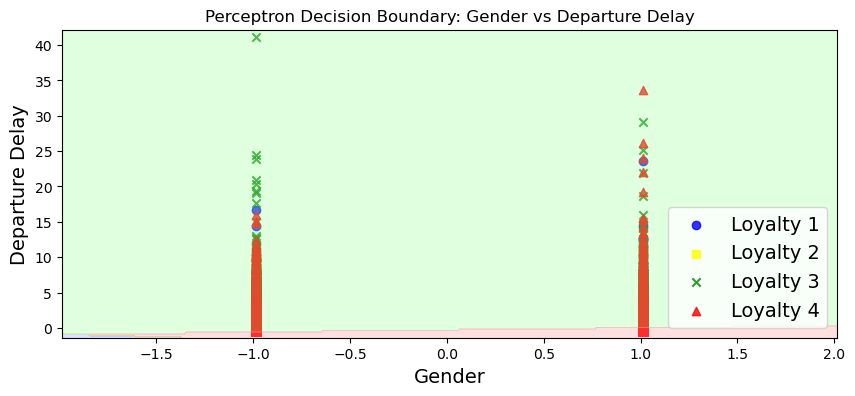

...

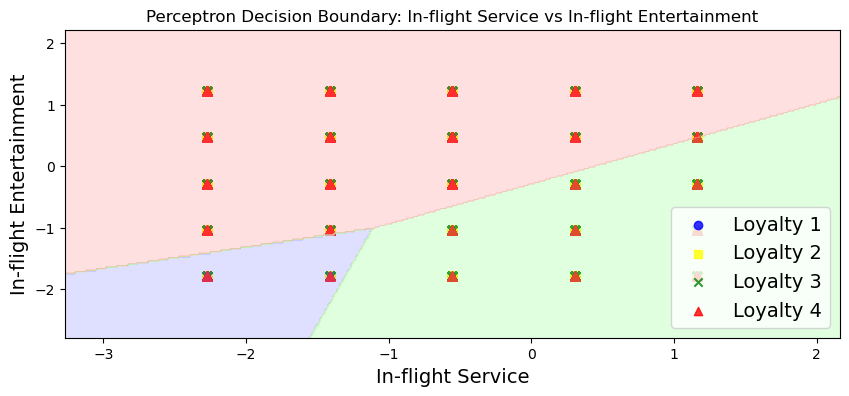

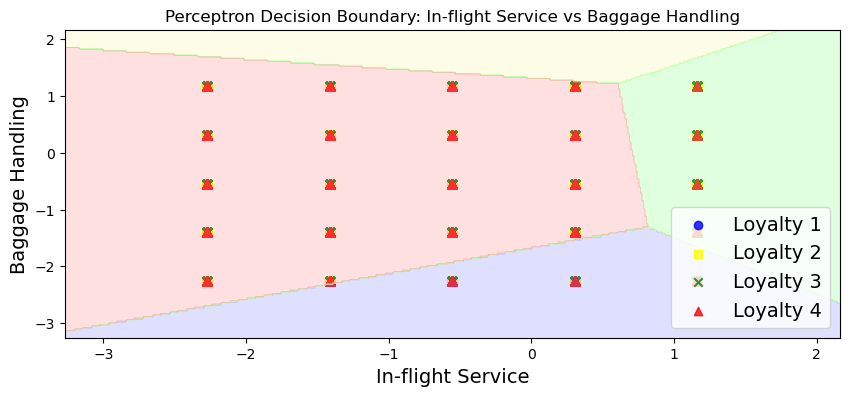

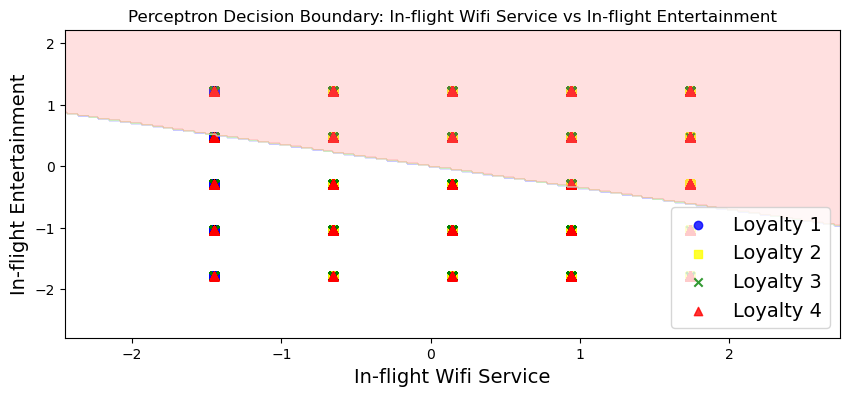

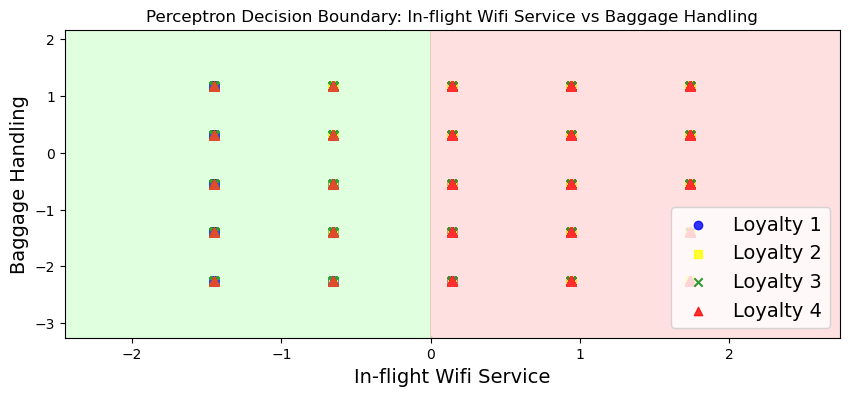

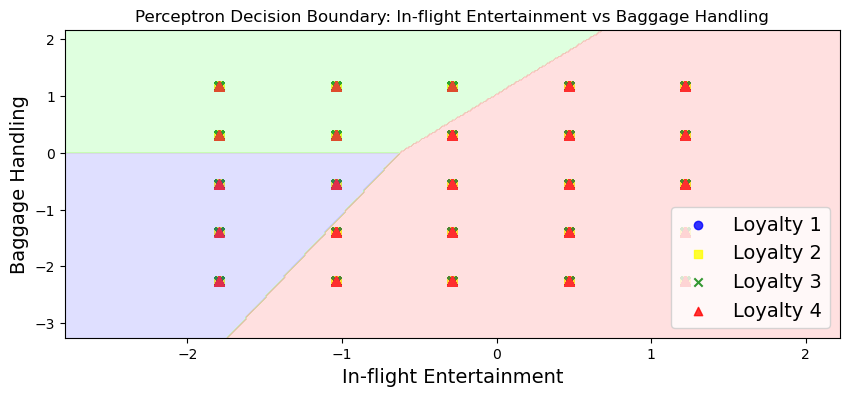

                   Feature 1                Feature 2  Accuracy (%)
0                     Gender                      Age     40.181484
1                     Gender           Type of Travel     53.838756
2                     Gender                    Class     64.313791
3                     Gender          Flight Distance     47.340470
4                     Gender          Departure Delay     43.857155
..                       ...                      ...           ...
205        In-flight Service  In-flight Entertainment     51.760475
206        In-flight Service         Baggage Handling     31.935268
207   In-flight Wifi Service  In-flight Entertainment     62.507318
208   In-flight Wifi Service         Baggage Handling     50.347077
209  In-flight Entertainment         Baggage Handling     47.603914

[210 rows x 3 columns]


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Perceptron
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from matplotlib.colors import ListedColormap

# Step 1: Load the data
url = "https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv"
data = pd.read_csv(url)

# Step 2: Prepare features and target
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Check and ensure target classes are 1, 2, 3, 4
assert set(y.unique()) == {1, 2, 3, 4}, "Target classes are not {1, 2, 3, 4}"

# Get feature names
feature_names = X.columns.tolist()

# List to store the results of accuracies
accuracy_results = []

# Iterate over pairs of all features
for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        feature_x = feature_names[i]
        feature_y = feature_names[j]

        # Extract the selected features
        X_selected = X[[feature_x, feature_y]].values

        # Standardize the selected features
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_selected)

        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

        # Initialize and train the Perceptron model
        per_clf = Perceptron(random_state=42)
        per_clf.fit(X_train, y_train)

        # Evaluate the model accuracy on the test set
        y_pred = per_clf.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        accuracy_results.append([feature_x, feature_y, accuracy * 100])

        # Plotting the decision boundary for visualization
        axes = [X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1,
                X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1]

        # Create a mesh grid for visualization
        x0, x1 = np.meshgrid(
            np.linspace(axes[0], axes[1], 500),
            np.linspace(axes[2], axes[3], 200)
        )
        X_new = np.c_[x0.ravel(), x1.ravel()]

        # Predict using the trained Perceptron model
        y_predict = per_clf.predict(X_new)
        zz = y_predict.reshape(x0.shape)

        # Plot the decision boundary and data points
        plt.figure(figsize=(10, 4))

        # Scatter plot of the points
        for class_label, color, marker in zip([1, 2, 3, 4], ['blue', 'yellow', 'green', 'red'], ['o', 's', 'x', '^']):
            plt.scatter(
                X_scaled[y == class_label, 0], X_scaled[y == class_label, 1],
                color=color, marker=marker, label=f"Loyalty {class_label}", alpha=0.8
            )

        # Create a custom colormap
        custom_cmap = ListedColormap(['#9898ff', '#fafab0', '#98ff98', '#ff9999'])

        # Contour plot of decision regions
        plt.contourf(x0, x1, zz, cmap=custom_cmap, alpha=0.3)

        # Set plot labels
        plt.xlabel(feature_x, fontsize=14)
        plt.ylabel(feature_y, fontsize=14)
        plt.legend(loc="lower right", fontsize=14)
        plt.axis(axes)
        plt.title(f"Perceptron Decision Boundary: {feature_x} vs {feature_y}")
        plt.show()

# Create a DataFrame to display the results
accuracy_df = pd.DataFrame(accuracy_results, columns=["Feature 1", "Feature 2", "Accuracy (%)"])

# Display the results
print(accuracy_df)





## Perceptron decision boundary for selected features

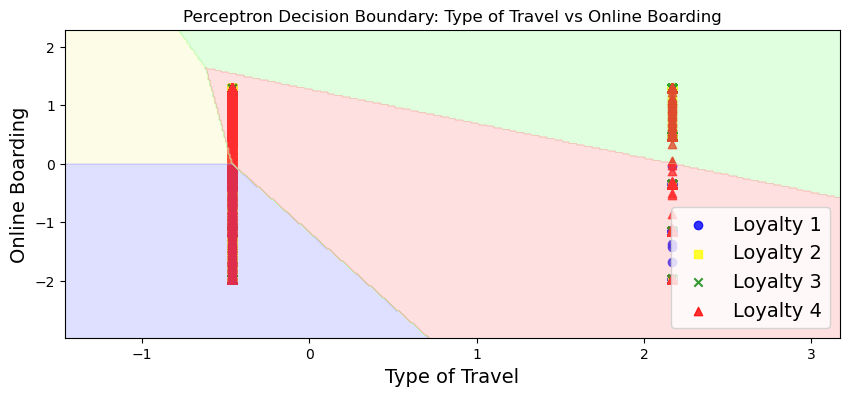

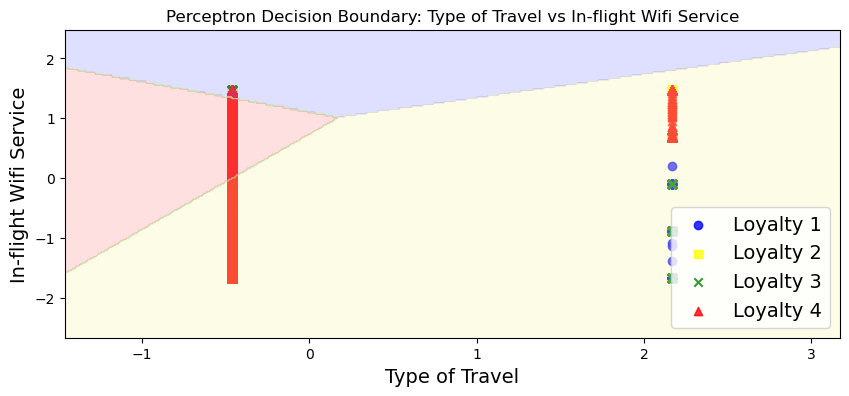

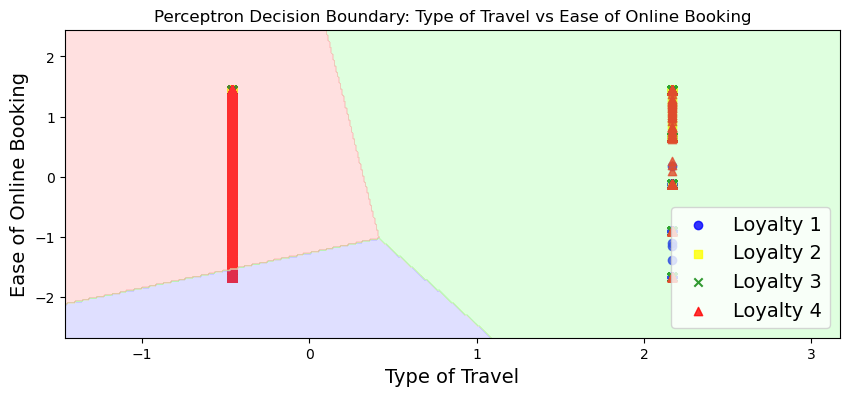

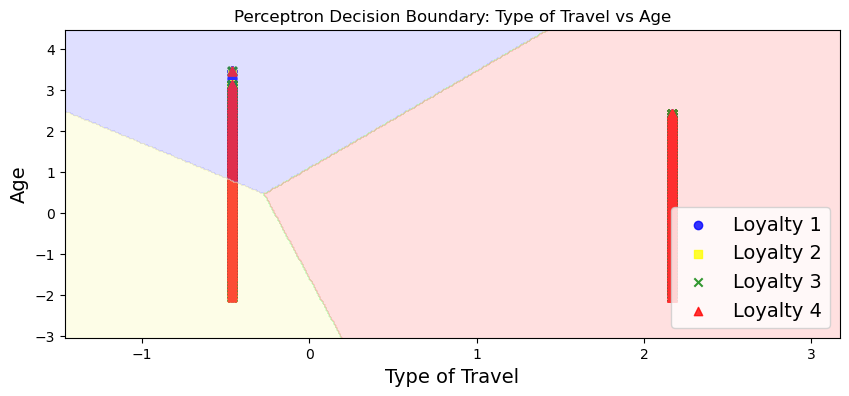

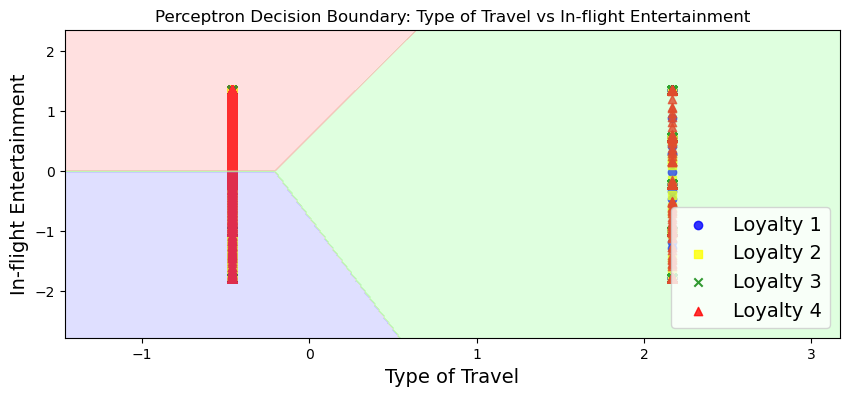

...

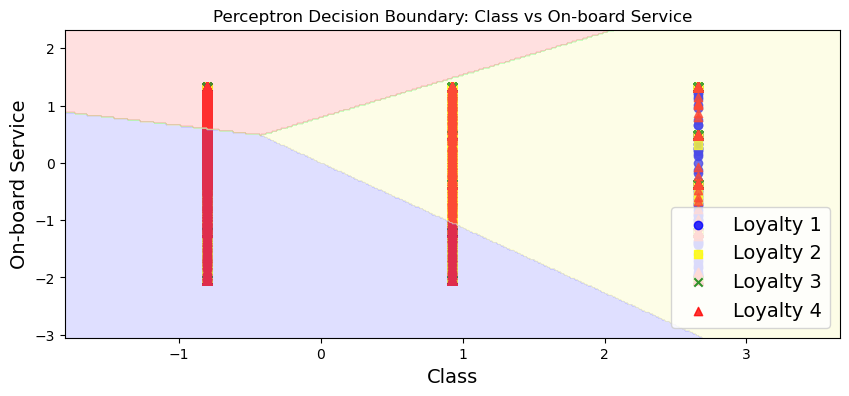

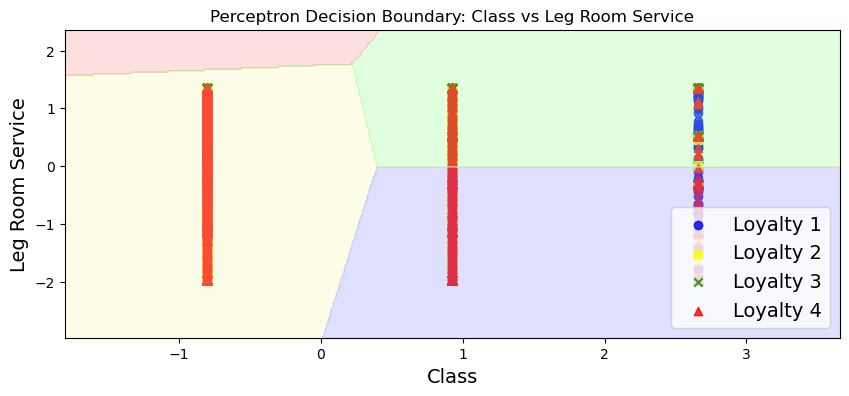

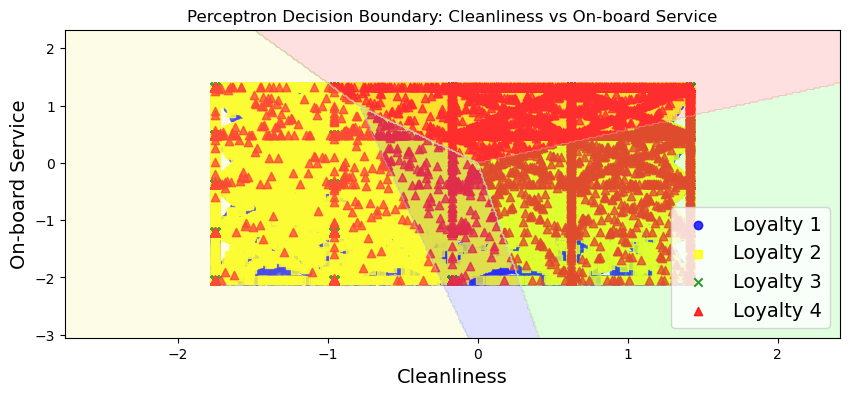

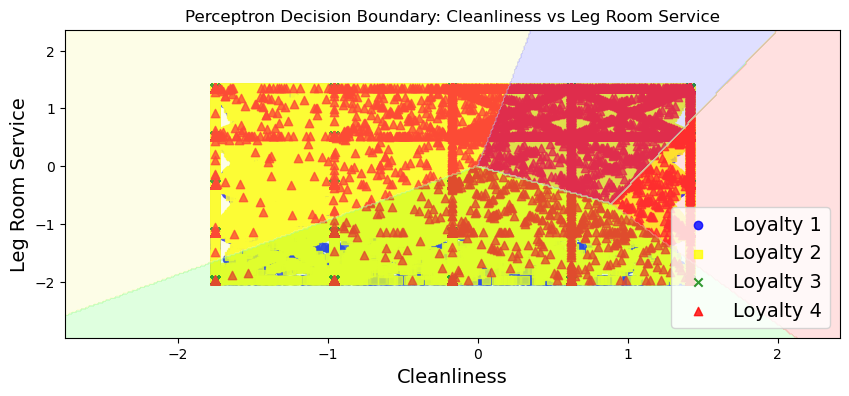

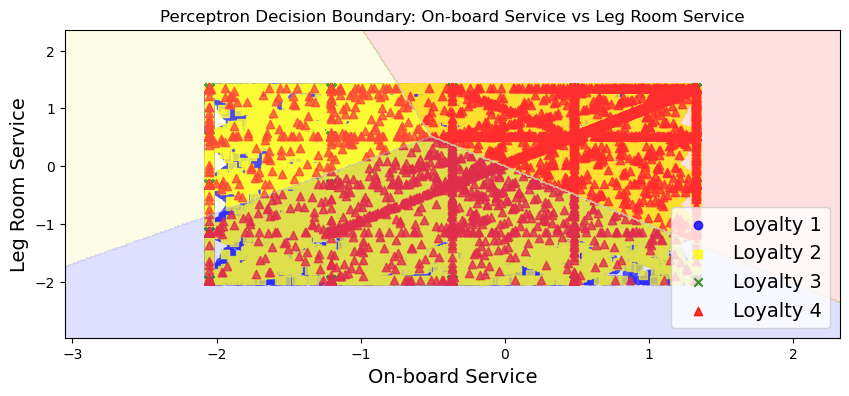

           Feature 1                Feature 2  Accuracy (%)
0     Type of Travel          Online Boarding     45.529860
1     Type of Travel   In-flight Wifi Service     37.370701
2     Type of Travel   Ease of Online Booking     38.397993
3     Type of Travel                      Age     41.044335
4     Type of Travel  In-flight Entertainment     50.228419
..               ...                      ...           ...
73             Class         On-board Service     35.784789
74             Class         Leg Room Service     35.943381
75       Cleanliness         On-board Service     31.857883
76       Cleanliness         Leg Room Service     29.845906
77  On-board Service         Leg Room Service     31.462589

[78 rows x 3 columns]


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Perceptron
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from matplotlib.colors import ListedColormap

# Step 1: Load the data
url = "https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/feature_selected_data.csv"
data = pd.read_csv(url)

# Step 2: Prepare features and target
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Check and ensure target classes are 1, 2, 3, 4
assert set(y.unique()) == {1, 2, 3, 4}, "Target classes are not {1, 2, 3, 4}"

# Get feature names
feature_names = X.columns.tolist()

# List to store the results of accuracies
accuracy_results = []

# Iterate over pairs of all features
for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        feature_x = feature_names[i]
        feature_y = feature_names[j]

        # Extract the selected features
        X_selected = X[[feature_x, feature_y]].values

        # Standardize the selected features
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_selected)

        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

        # Initialize and train the Perceptron model
        per_clf = Perceptron(random_state=42)
        per_clf.fit(X_train, y_train)

        # Evaluate the model accuracy on the test set
        y_pred = per_clf.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        accuracy_results.append([feature_x, feature_y, accuracy * 100])

        # Plotting the decision boundary for visualization
        axes = [X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1,
                X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1]

        # Create a mesh grid for visualization
        x0, x1 = np.meshgrid(
            np.linspace(axes[0], axes[1], 500),
            np.linspace(axes[2], axes[3], 200)
        )
        X_new = np.c_[x0.ravel(), x1.ravel()]

        # Predict using the trained Perceptron model
        y_predict = per_clf.predict(X_new)
        zz = y_predict.reshape(x0.shape)

        # Plot the decision boundary and data points
        plt.figure(figsize=(10, 4))

        # Scatter plot of the points
        for class_label, color, marker in zip([1, 2, 3, 4], ['blue', 'yellow', 'green', 'red'], ['o', 's', 'x', '^']):
            plt.scatter(
                X_scaled[y == class_label, 0], X_scaled[y == class_label, 1],
                color=color, marker=marker, label=f"Loyalty {class_label}", alpha=0.8
            )

        # Create a custom colormap
        custom_cmap = ListedColormap(['#9898ff', '#fafab0', '#98ff98', '#ff9999'])

        # Contour plot of decision regions
        plt.contourf(x0, x1, zz, cmap=custom_cmap, alpha=0.3)

        # Set plot labels
        plt.xlabel(feature_x, fontsize=14)
        plt.ylabel(feature_y, fontsize=14)
        plt.legend(loc="lower right", fontsize=14)
        plt.axis(axes)
        plt.title(f"Perceptron Decision Boundary: {feature_x} vs {feature_y}")
        plt.show()

# Create a DataFrame to display the results
accuracy_df = pd.DataFrame(accuracy_results, columns=["Feature 1", "Feature 2", "Accuracy (%)"])

# Display the results
print(accuracy_df)





### Training an MLP Neural Network Classifier and Visualizing Activation Probabilities for Customer Loyalty Prediction


Accuracy: 91.70%


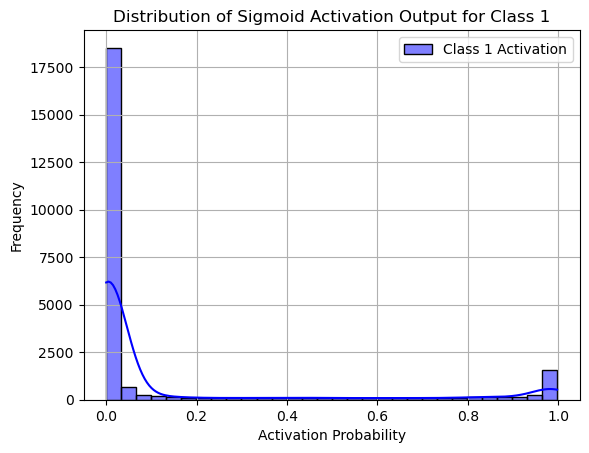

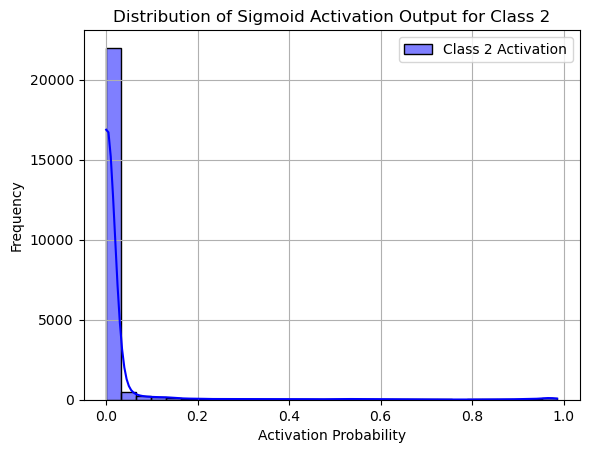

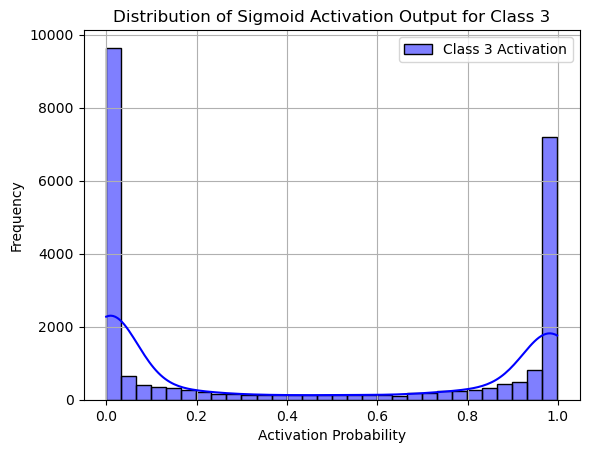

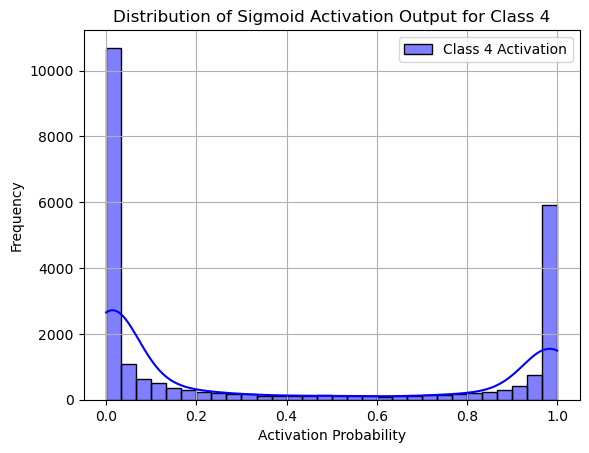

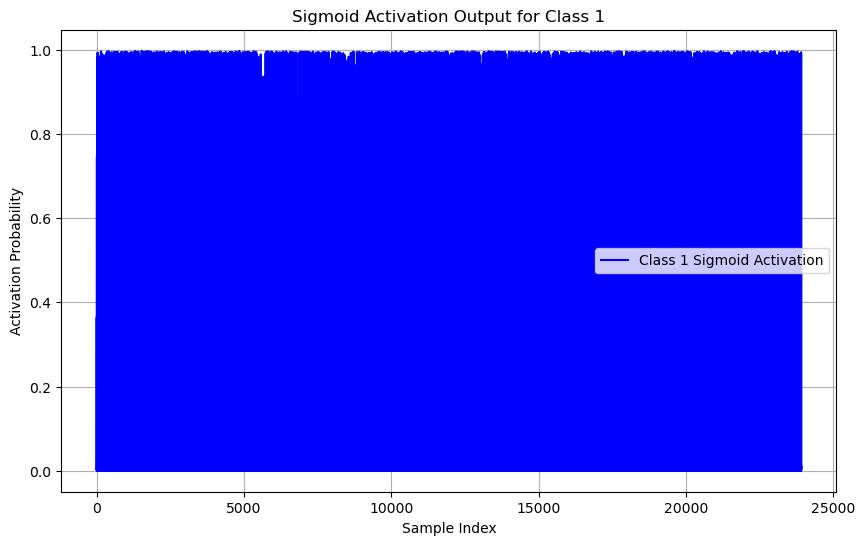

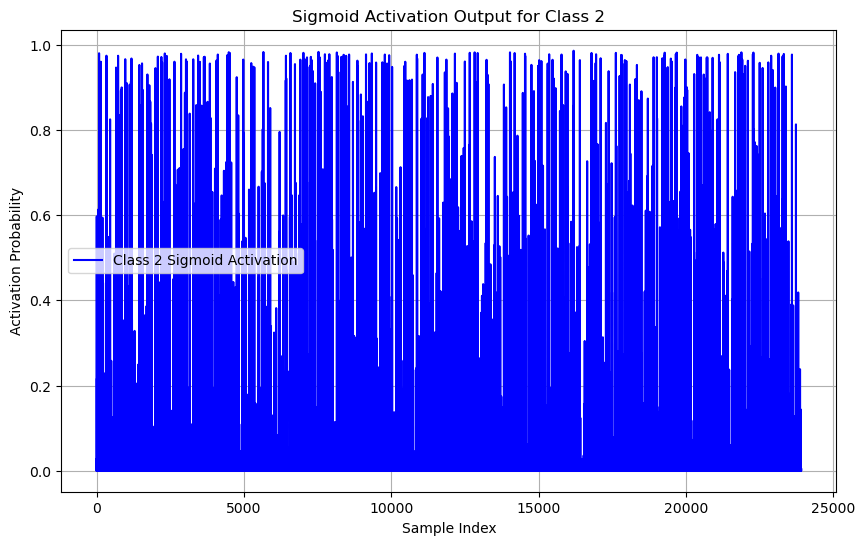

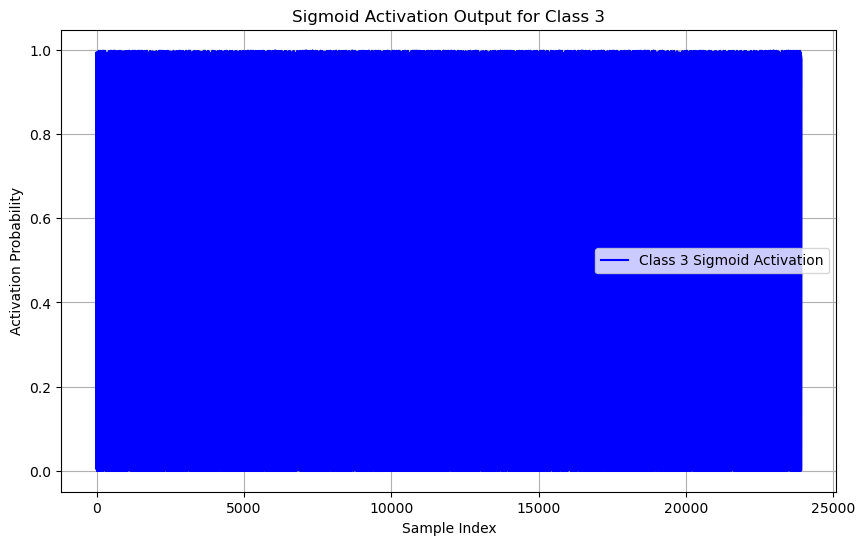

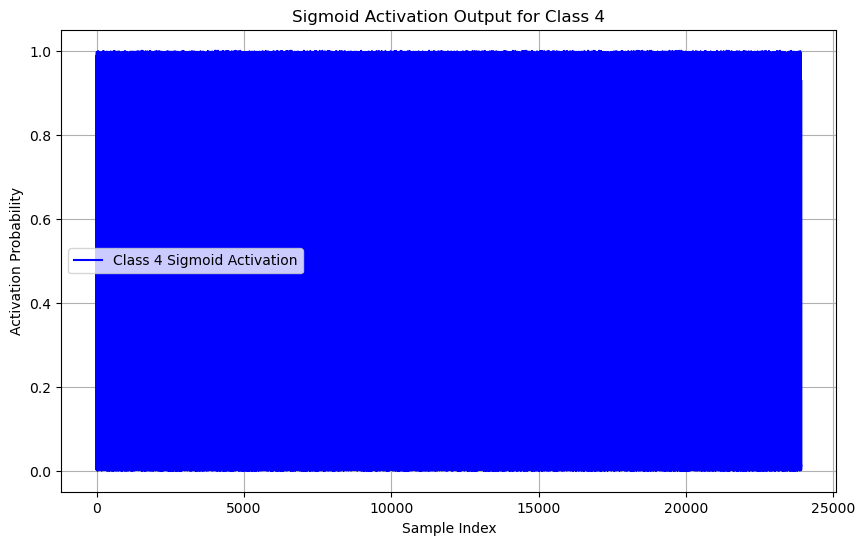

In [19]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset from the URL
data_url = 'https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv'
data = pd.read_csv(data_url)

# Separate features (X) and target (y)
X = data.drop(columns=['Loyalty'])  
y = data['Loyalty']  # 'Loyalty' is the target variable

# Split the dataset into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a neural network with a sigmoid activation function
model = MLPClassifier(hidden_layer_sizes=(10,), activation='logistic', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Evaluate the model's accuracy
accuracy = model.score(X_test, y_test)
print(f'Accuracy: {accuracy * 100:.2f}%')

# Visualize the activations (Sigmoid activation outputs for all classes)
activations = model.predict_proba(X_test)  # Get output from the output layer (probabilities)

# Check distributions of activation probabilities for each class
for i in range(4):  # 4 classes (loyalty 1, 2, 3, 4)
    sns.histplot(activations[:, i], kde=True, label=f'Class {i+1} Activation', color='b', bins=30)
    plt.title(f'Distribution of Sigmoid Activation Output for Class {i+1}')
    plt.xlabel('Activation Probability')
    plt.ylabel('Frequency')
    plt.legend()
    plt.grid(True)
    plt.show()

# Create separate plots for each class
for i in range(4):  # 4 classes (loyalty 1, 2, 3, 4)
    plt.figure(figsize=(10, 6))
    plt.plot(activations[:, i], label=f'Class {i+1} Sigmoid Activation', color='b')
    plt.title(f'Sigmoid Activation Output for Class {i+1}')
    plt.xlabel('Sample Index')
    plt.ylabel('Activation Probability')
    plt.legend()
    plt.grid(True)
    plt.show()


## for selected features 

Accuracy: 87.67%


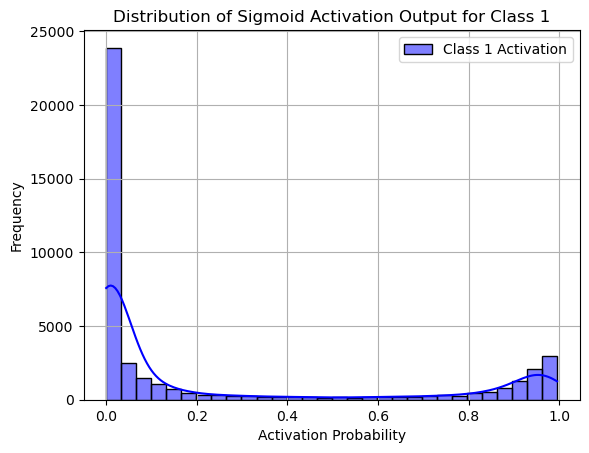

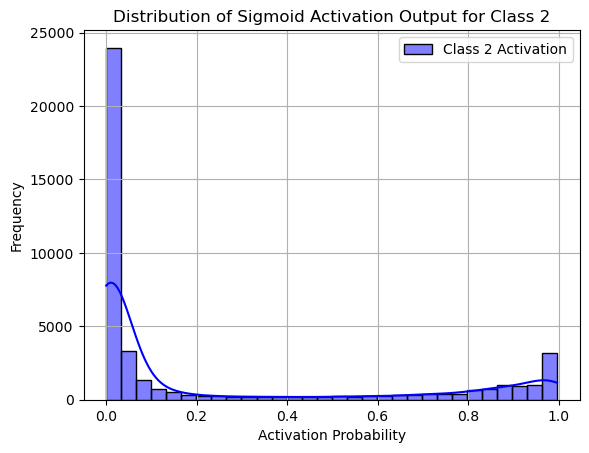

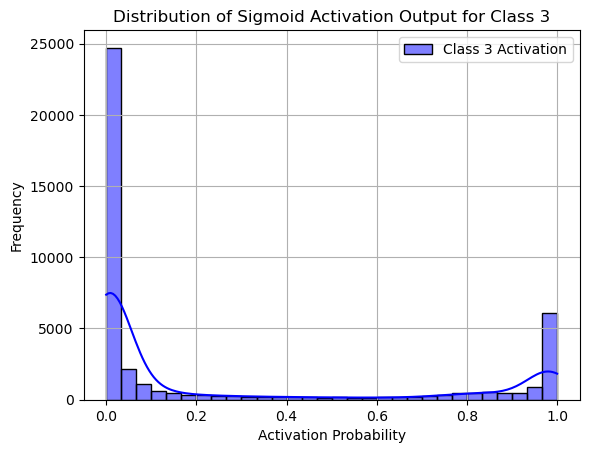

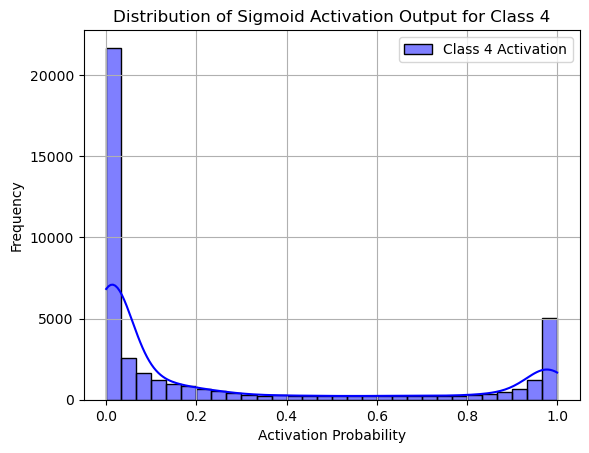

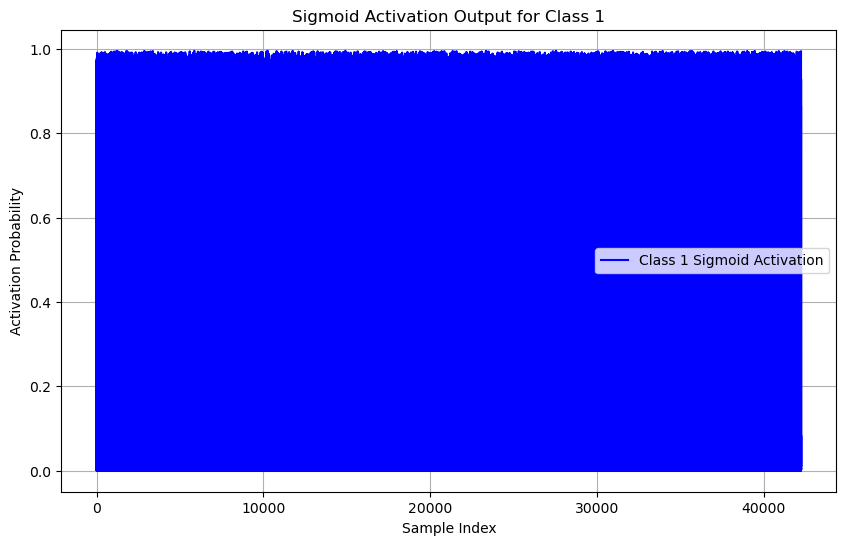

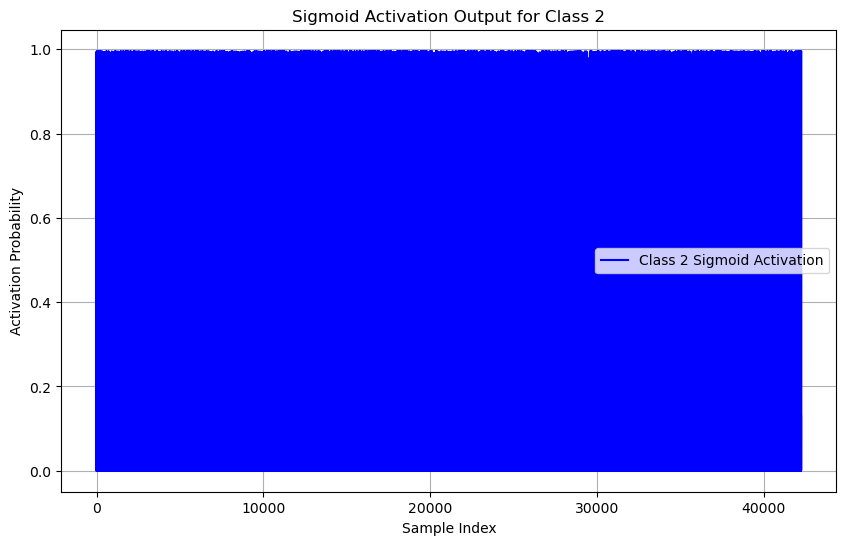

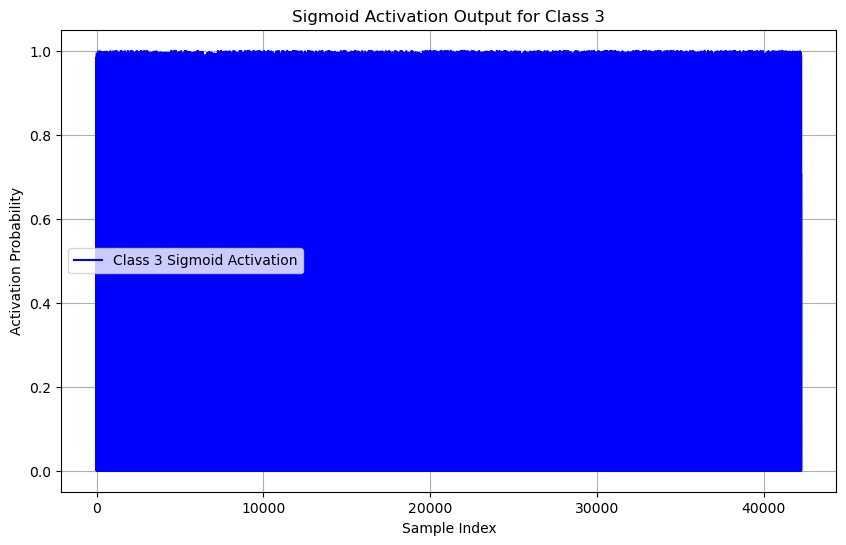

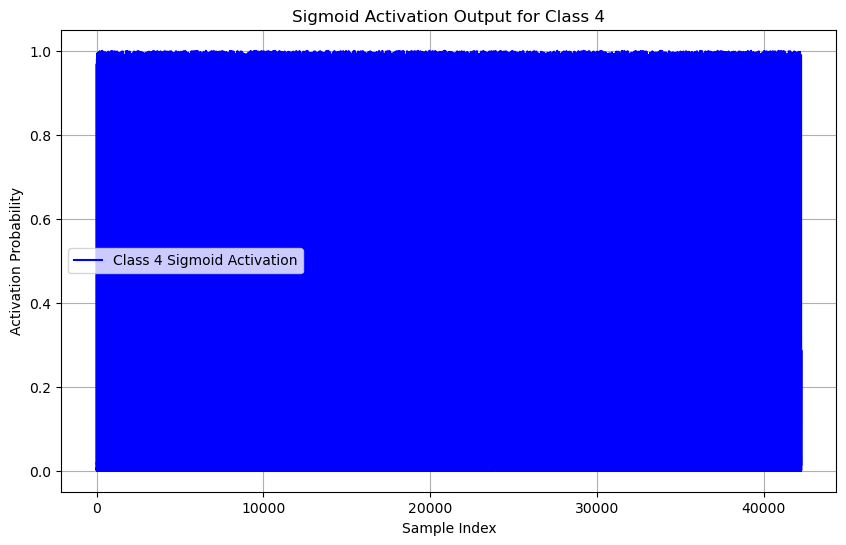

In [4]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset from the URL
data_url = 'https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/feature_selected_data.csv'
data = pd.read_csv(data_url)

# Separate features (X) and target (y)
X = data.drop(columns=['Loyalty'])  
y = data['Loyalty']  # 'Loyalty' is the target variable

# Check and ensure target classes are 1, 2, 3, 4
assert set(y.unique()) == {1, 2, 3, 4}, "Target classes are not {1, 2, 3, 4}"

# Select the features you want to use (all features in this case, but you can specify a subset)
selected_features = X.columns.tolist()

# Split the dataset into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X[selected_features], y, test_size=0.2, random_state=42)

# Create a neural network with a sigmoid activation function
model = MLPClassifier(hidden_layer_sizes=(10,), activation='logistic', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Evaluate the model's accuracy
accuracy = model.score(X_test, y_test)
print(f'Accuracy: {accuracy * 100:.2f}%')

# Visualize the activations (Sigmoid activation outputs for all classes)
activations = model.predict_proba(X_test)  # Get output from the output layer (probabilities)

# Check distributions of activation probabilities for each class
for i in range(4):  # 4 classes (loyalty 1, 2, 3, 4)
    sns.histplot(activations[:, i], kde=True, label=f'Class {i+1} Activation', color='b', bins=30)
    plt.title(f'Distribution of Sigmoid Activation Output for Class {i+1}')
    plt.xlabel('Activation Probability')
    plt.ylabel('Frequency')
    plt.legend()
    plt.grid(True)
    plt.show()

# Create separate plots for each class
for i in range(4):  # 4 classes (loyalty 1, 2, 3, 4)
    plt.figure(figsize=(10, 6))
    plt.plot(activations[:, i], label=f'Class {i+1} Sigmoid Activation', color='b')
    plt.title(f'Sigmoid Activation Output for Class {i+1}')
    plt.xlabel('Sample Index')
    plt.ylabel('Activation Probability')
    plt.legend()
    plt.grid(True)
    plt.show()


### Training an MLP Neural Network Classifier with SMOTE Resampling for Customer Loyalty Prediction


Accuracy: 88.84%


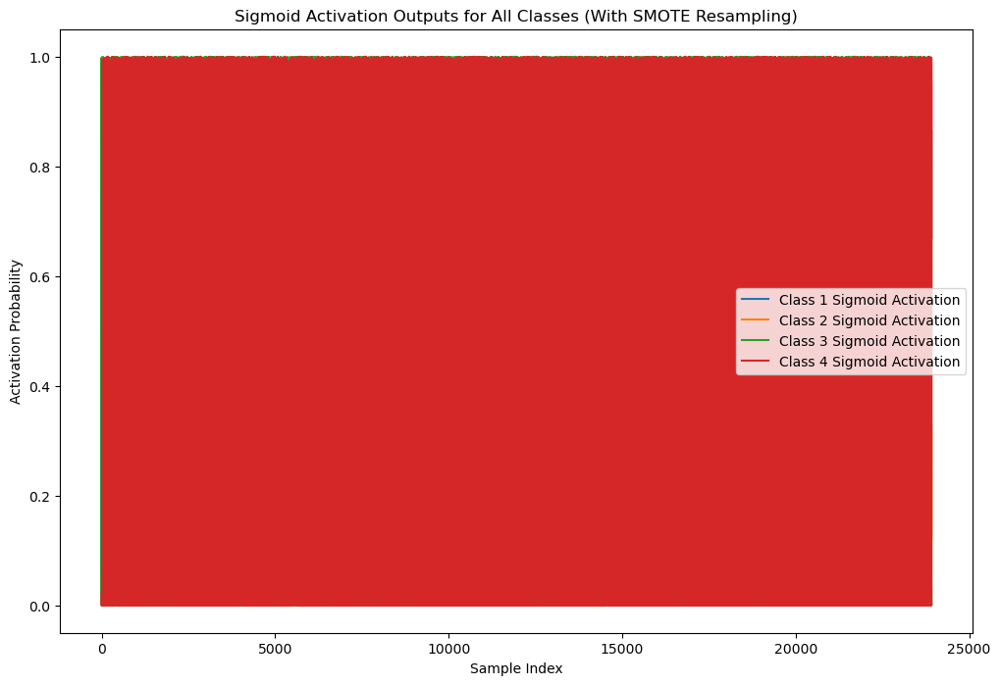

In [21]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_url = 'https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv'
data = pd.read_csv(data_url)

# Separate features (X) and target (y)
X = data.drop(columns=['Loyalty'])  # All columns except 'Loyalty' are features
y = data['Loyalty']  # 'Loyalty' is the target variable

# Split the dataset into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE to balance the dataset
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Create a neural network with a sigmoid activation function, L2 regularization, and no class weights
model = MLPClassifier(
    hidden_layer_sizes=(10,), 
    activation='logistic', 
    random_state=42, 
    max_iter=1000,  # Increase iterations if needed
    alpha=0.001,  # L2 regularization (Ridge)
    solver='adam'  # Adam optimizer is often more efficient
)

# Train the model
model.fit(X_train_resampled, y_train_resampled)

# Evaluate the model's accuracy
accuracy = model.score(X_test, y_test)
print(f'Accuracy: {accuracy * 100:.2f}%')

# Visualize the activations (Sigmoid activation outputs for all classes)
activations = model.predict_proba(X_test)  # Get output from the output layer (probabilities)

# Plot activations for each class
plt.figure(figsize=(12, 8))
for i in range(4):  # 4 classes (loyalty 1, 2, 3, 4)
    plt.plot(activations[:, i], label=f'Class {i+1} Sigmoid Activation')

plt.legend()
plt.title('Sigmoid Activation Outputs for All Classes (With SMOTE Resampling)')
plt.xlabel('Sample Index')
plt.ylabel('Activation Probability')
plt.show()



Accuracy: 87.37%


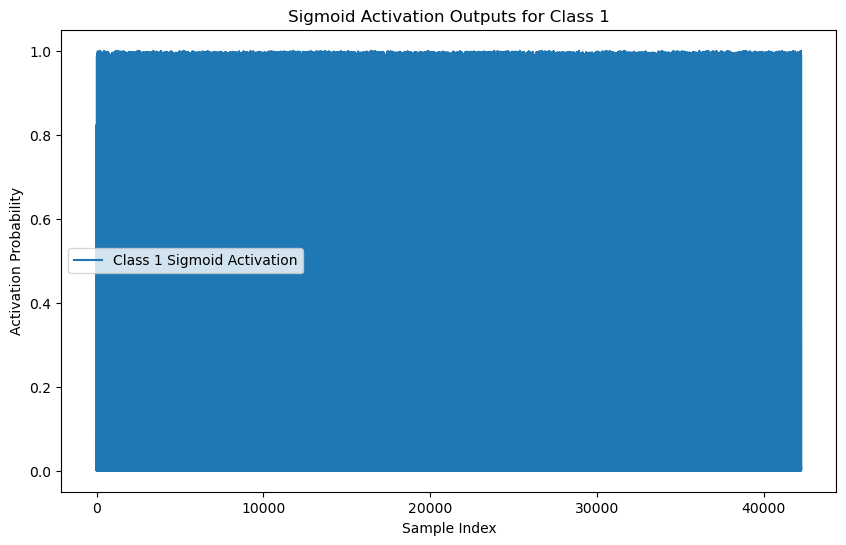

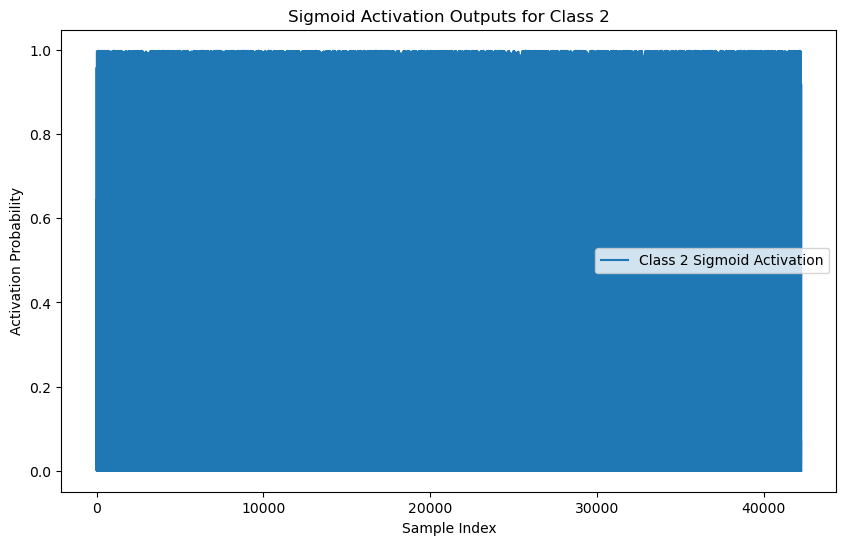

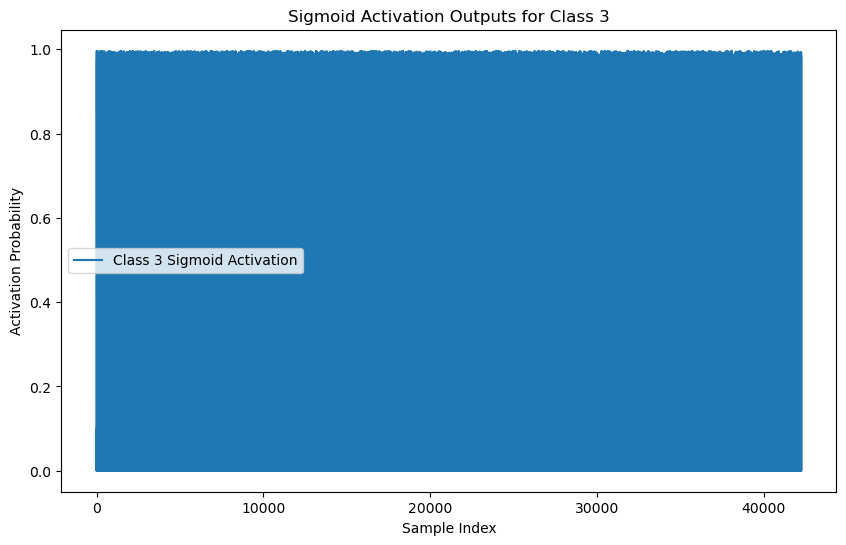

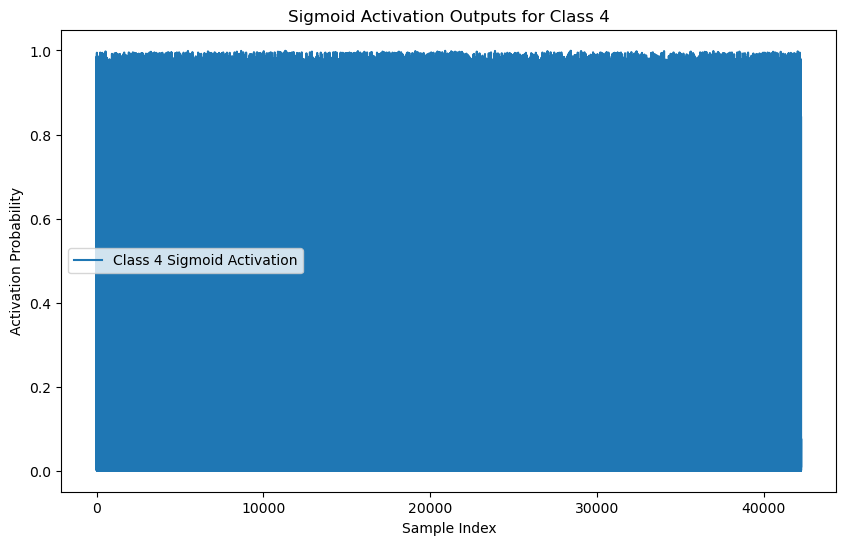

In [5]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_url = 'https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/feature_selected_data.csv'
data = pd.read_csv(data_url)

# Separate features (X) and target (y)
X = data.drop(columns=['Loyalty'])  
y = data['Loyalty']  # 'Loyalty' is the target variable

# Split the dataset into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE to balance the dataset
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Create a neural network with a sigmoid activation function, L2 regularization, and no class weights
model = MLPClassifier(
    hidden_layer_sizes=(10,), 
    activation='logistic', 
    random_state=42, 
    max_iter=1000,  # Increase iterations if needed
    alpha=0.001,  # L2 regularization (Ridge)
    solver='adam'  # Adam optimizer is often more efficient
)

# Train the model
model.fit(X_train_resampled, y_train_resampled)

# Evaluate the model's accuracy
accuracy = model.score(X_test, y_test)
print(f'Accuracy: {accuracy * 100:.2f}%')

# Visualize the activations (Sigmoid activation outputs for all classes)
activations = model.predict_proba(X_test)  # Get output from the output layer (probabilities)

# Plot activations for each class separately
for i in range(4):  # 4 classes (loyalty 1, 2, 3, 4)
    plt.figure(figsize=(10, 6))
    plt.plot(activations[:, i], label=f'Class {i+1} Sigmoid Activation')
    plt.legend()
    plt.title(f'Sigmoid Activation Outputs for Class {i+1}')
    plt.xlabel('Sample Index')
    plt.ylabel('Activation Probability')
    plt.show()


# Visualizing the Sigmoid Function and Its Derivative for Large Input Values


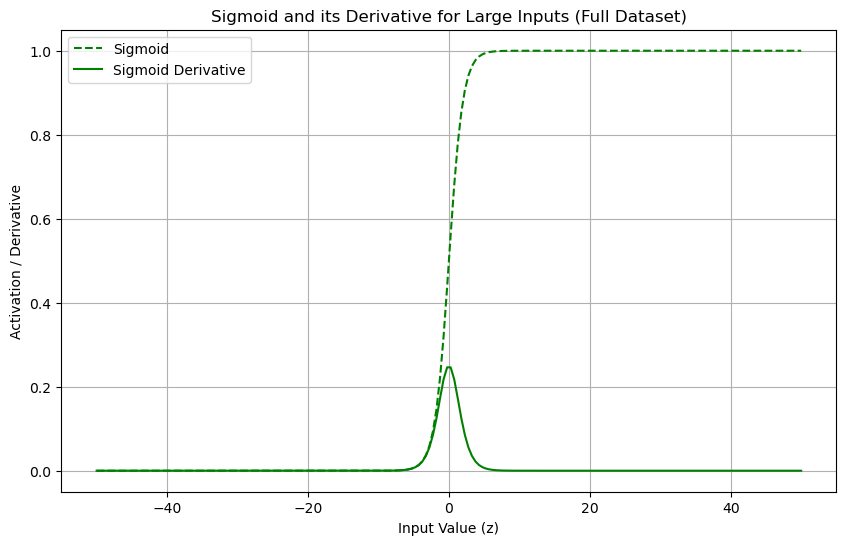

In [25]:
import pandas as pd
import seaborn as sns

# Load the dataset
df = pd.read_csv("https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv")

# Define the sigmoid and its derivative functions
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

def derivative(sigmoid_function, z):
    return sigmoid_function(z) * (1 - sigmoid_function(z))

# Generate z values
z_large = np.linspace(-50, 50, 200)

# Plot for the entire dataset (using all features)
plt.figure(figsize=(10, 6))
plt.plot(z_large, sigmoid(z_large), "g--", label="Sigmoid")
plt.plot(z_large, derivative(sigmoid, z_large), "g-", label="Sigmoid Derivative")
plt.title("Sigmoid and its Derivative for Large Inputs (Full Dataset)")
plt.xlabel("Input Value (z)")
plt.ylabel("Activation / Derivative")
plt.legend()
plt.grid(True)
plt.show()


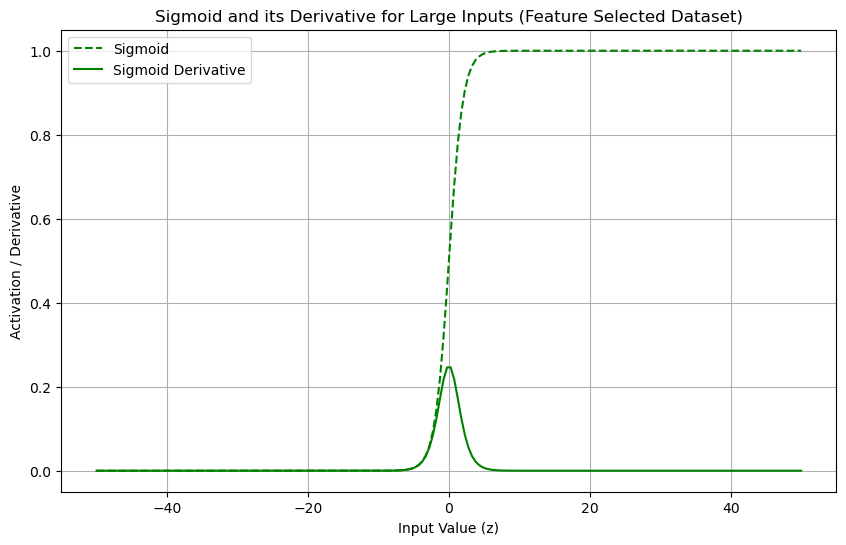

In [7]:
import pandas as pd
import seaborn as sns

# Load the dataset
df = pd.read_csv("https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/feature_selected_data.csv")

# Define the sigmoid and its derivative functions
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

def derivative(sigmoid_function, z):
    return sigmoid_function(z) * (1 - sigmoid_function(z))

# Generate z values
z_large = np.linspace(-50, 50, 200)

# Plot for the entire dataset (using all features)
plt.figure(figsize=(10, 6))
plt.plot(z_large, sigmoid(z_large), "g--", label="Sigmoid")
plt.plot(z_large, derivative(sigmoid, z_large), "g-", label="Sigmoid Derivative")
plt.title("Sigmoid and its Derivative for Large Inputs (Feature Selected Dataset)")
plt.xlabel("Input Value (z)")
plt.ylabel("Activation / Derivative")
plt.legend()
plt.grid(True)
plt.show()


Applying LAB requirements 

# Multiclass Classification with Neural Network, Cross-Validation, and Performance Metrics Evaluation


Cross-validated accuracy: 93.26%
Epoch 1/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7580 - loss: 0.6374
Epoch 2/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.8734 - loss: 0.3524
Epoch 3/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.8979 - loss: 0.2952
Epoch 4/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9090 - loss: 0.2647
Epoch 5/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9160 - loss: 0.2459
Epoch 6/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9198 - loss: 0.2348
Epoch 7/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9212 - loss: 0.2268
Epoch 8/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9275 - loss: 0.2110
Epoch 9/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9281 - loss: 0.2086
Epoch 10/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9294 - loss: 0.2046
Epoch 11/20
2990/2990 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9307 - loss: 0.19

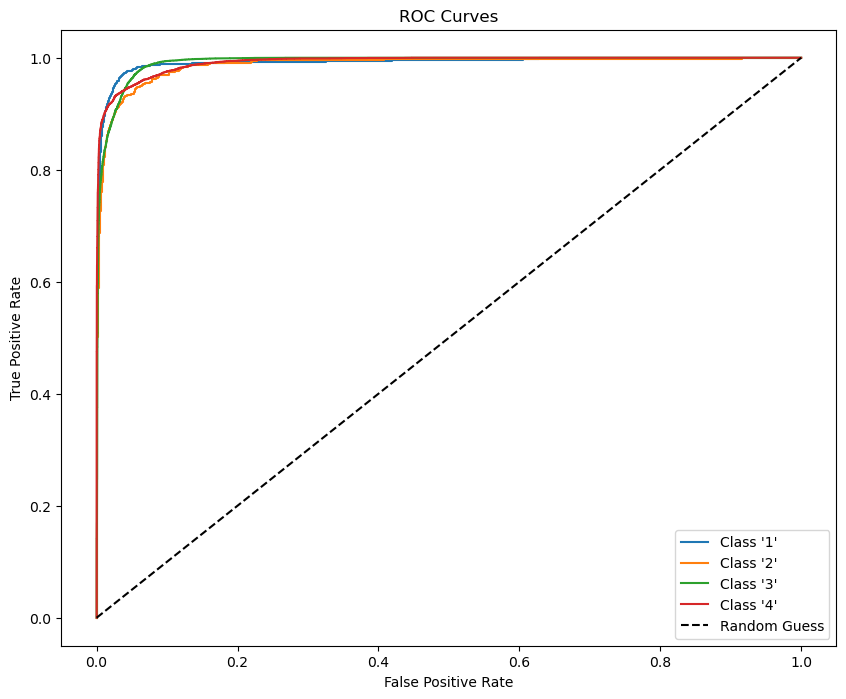

In [8]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.optimizers import SGD
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, 
    confusion_matrix, roc_auc_score, classification_report, roc_curve
)
from tensorflow.keras.utils import to_categorical

# Step 1: Load the data
url = "https://raw.githubusercontent.com/HWhr3000/F21DL_Coursework_grp2/main/data/encoded/encoded_data.csv"
data = pd.read_csv(url)

# Step 2: Prepare the features and target
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Encode the target column (categorical to numerical)
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Convert labels to one-hot encoding for Keras
y = to_categorical(y)

# Step 3: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 4: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Function to create a Perceptron model for multiclass classification
def create_model(input_shape, num_classes):
    model = Sequential([
        Input(shape=(input_shape,)),  # Specify input shape here
        Dense(64, activation='relu'),  # Hidden layer with ReLU activation
        Dense(num_classes, activation='softmax')  # Output layer with softmax activation
    ])
    model.compile(optimizer=SGD(learning_rate=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Perform 10-fold cross-validation manually
kf = KFold(n_splits=10, shuffle=True, random_state=42)
cv_scores = []

for train_index, val_index in kf.split(X_train):
    # Extract folds
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Create and train the model
    model = create_model(X_train.shape[1], y_train.shape[1])
    model.fit(X_train_fold, y_train_fold, epochs=15, batch_size=32, verbose=0)  # Train for 15 epochs
    
    # Evaluate the model on the validation fold
    val_loss, val_accuracy = model.evaluate(X_val_fold, y_val_fold, verbose=0)
    cv_scores.append(val_accuracy)

# Print the cross-validated accuracy
print(f"Cross-validated accuracy: {np.mean(cv_scores) * 100:.2f}%")

# Train the model on the full training set
model = create_model(X_train.shape[1], y_train.shape[1])
model.fit(X_train, y_train, epochs=20, batch_size=32, verbose=1)  # Train for 20 epochs

# Predict on the test set
y_pred = model.predict(X_test)

# Convert predictions and true values to class indices
y_pred_labels = np.argmax(y_pred, axis=1)
y_test_labels = np.argmax(y_test, axis=1)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test_labels, y_pred_labels)

# Calculate metrics: TPR, FPR, Precision, Recall, F1 Score
tpr = []
fpr = []

for i in range(len(conf_matrix)):
    tp = conf_matrix[i, i]
    fn = np.sum(conf_matrix[i, :]) - tp
    fp = np.sum(conf_matrix[:, i]) - tp
    tn = np.sum(conf_matrix) - (tp + fn + fp)
    
    # True Positive Rate (Recall)
    tpr.append(tp / (tp + fn) if (tp + fn) > 0 else 0)
    
    # False Positive Rate
    fpr.append(fp / (fp + tn) if (fp + tn) > 0 else 0)

# Calculate overall metrics
accuracy = accuracy_score(y_test_labels, y_pred_labels)
precision = precision_score(y_test_labels, y_pred_labels, average='weighted', zero_division=0)
recall = recall_score(y_test_labels, y_pred_labels, average='weighted', zero_division=0)
f1 = f1_score(y_test_labels, y_pred_labels, average='weighted', zero_division=0)
roc_auc = roc_auc_score(y_test, y_pred, multi_class='ovr')

# Print results
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision * 100:.2f}%")
print(f"Recall (Weighted Average): {recall * 100:.2f}%")
print(f"F1 Score: {f1 * 100:.2f}%")
print(f"ROC AUC Score: {roc_auc:.2f}")

# Print TPR and FPR for each class
for i, class_name in enumerate(label_encoder.classes_):
    print(f"Class '{class_name}': TPR (Recall) = {tpr[i]:.2f}, FPR = {fpr[i]:.2f}")

# Classification report for more detailed metrics
print("\nClassification Report:")
print(classification_report(y_test_labels, y_pred_labels, zero_division=0))

 Plot ROC curves for each class
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
for i, class_name in enumerate(label_encoder.classes_):
    fpr_class, tpr_class, _ = roc_curve(y_test[:, i], y_pred[:, i])
    plt.plot(fpr_class, tpr_class, label=f"Class '{class_name}'")
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.title("ROC Curves")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.show()


## 10 k fold for features selected data 

In [7]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.optimizers import SGD
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, 
    confusion_matrix, roc_auc_score, classification_report
)
from tensorflow.keras.utils import to_categorical

# Step 1: Load the data
url = "https://github.com/HWhr3000/F21DL_Coursework_grp2/blob/main/data/feature_selected_data.csv?raw=true"
data = pd.read_csv(url)

# Step 2: Prepare the features and target
# 'Loyalty' is the target column and the rest are features
X = data.drop(columns=['Loyalty'])  # Features
y = data['Loyalty']  # Target

# Encode the target column (categorical to numerical)
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Convert labels to one-hot encoding for Keras
y = to_categorical(y)

# Step 3: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 4: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Function to create a Perceptron model for multiclass classification
def create_model(input_shape, num_classes):
    model = Sequential([
        Input(shape=(input_shape,)),  # Specify input shape here
        Dense(64, activation='relu'),  # Hidden layer with ReLU activation
        Dense(num_classes, activation='softmax')  # Output layer with softmax activation
    ])
    model.compile(optimizer=SGD(learning_rate=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Perform 10-fold cross-validation manually
kf = KFold(n_splits=10, shuffle=True, random_state=42)
cv_scores = []

for train_index, val_index in kf.split(X_train):
    # Extract folds
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    
    # Create and train the model
    model = create_model(X_train.shape[1], y_train.shape[1])
    model.fit(X_train_fold, y_train_fold, epochs=15, batch_size=32, verbose=0)  # Train for 15 epochs
    
    # Evaluate the model on the validation fold
    val_loss, val_accuracy = model.evaluate(X_val_fold, y_val_fold, verbose=0)
    cv_scores.append(val_accuracy)

# Print the cross-validated accuracy
print(f"Cross-validated accuracy: {np.mean(cv_scores) * 100:.2f}%")

# Train the model on the full training set
model = create_model(X_train.shape[1], y_train.shape[1])
model.fit(X_train, y_train, epochs=20, batch_size=32, verbose=1)  # Train for 20 epochs

# Predict on the test set
y_pred = model.predict(X_test)

# Convert predictions and true values to class indices
y_pred_labels = np.argmax(y_pred, axis=1)
y_test_labels = np.argmax(y_test, axis=1)

# Calculate the major metrics
accuracy = accuracy_score(y_test_labels, y_pred_labels)
precision = precision_score(y_test_labels, y_pred_labels, average='weighted', zero_division=0)
recall = recall_score(y_test_labels, y_pred_labels, average='weighted', zero_division=0)
f1 = f1_score(y_test_labels, y_pred_labels, average='weighted', zero_division=0)
conf_matrix = confusion_matrix(y_test_labels, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred, multi_class='ovr')

# Output the results
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision * 100:.2f}%")
print(f"Recall: {recall * 100:.2f}%")
print(f"F1 Score: {f1 * 100:.2f}%")
print(f"Confusion Matrix:\n{conf_matrix}")
print(f"ROC AUC Score: {roc_auc:.2f}")

# Classification report for detailed metrics
print("\nClassification Report:")
print(classification_report(y_test_labels, y_pred_labels, zero_division=0))



Cross-validated accuracy: 90.73%
Epoch 1/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.7796 - loss: 0.6163
Epoch 2/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step - accuracy: 0.8688 - loss: 0.3756
Epoch 3/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.8836 - loss: 0.3344
Epoch 4/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.8879 - loss: 0.3176
Epoch 5/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.8931 - loss: 0.3018
Epoch 6/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.8972 - loss: 0.2923
Epoch 7/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.9004 - loss: 0.2839
Epoch 8/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - accuracy: 0.9020 - loss: 0.2774
Epoch 9/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - accuracy: 0.9025 - loss: 0.2753
Epoch 10/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - accuracy: 0.9033 - loss: 0.2722
Epoch 11/20
5281/5281 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - accuracy: 0.9051 - loss: 0.2

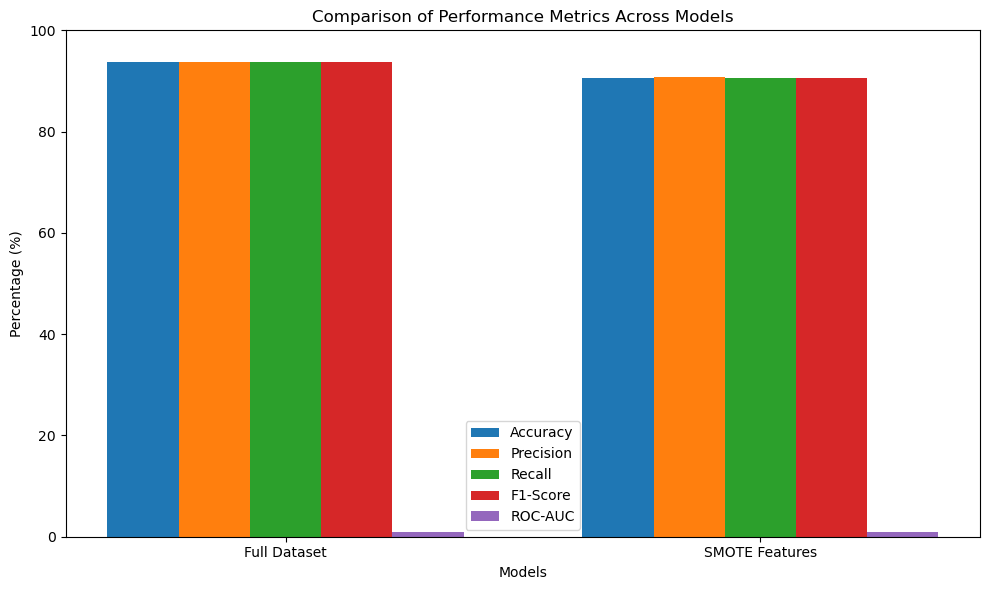

In [4]:
import matplotlib.pyplot as plt
import numpy as np

# Data
models = ["Full Dataset", "SMOTE Features"]
accuracy = [93.77, 90.68]
precision = [93.74, 90.70]
recall = [93.77, 90.68]
f1_score = [93.74, 90.68]
roc_auc = [0.99, 0.99]

# Metrics to compare
metrics = ["Accuracy", "Precision", "Recall", "F1-Score", "ROC-AUC"]
values = [accuracy, precision, recall, f1_score, roc_auc]

# Plot
x = np.arange(len(models))  # X positions for groups
width = 0.15  # Width of bars for each metric

plt.figure(figsize=(10, 6))
for i, metric in enumerate(values):
    plt.bar(x + i * width, metric, width, label=metrics[i])

# Adding labels and title
plt.xlabel("Models")
plt.ylabel("Percentage (%)")
plt.title("Comparison of Performance Metrics Across Models")
plt.xticks(x + width * 2, models)
plt.ylim(0, 100)  # Ensures all metrics fit within 0-100%
plt.legend()
plt.tight_layout()

# Display plot
plt.show()



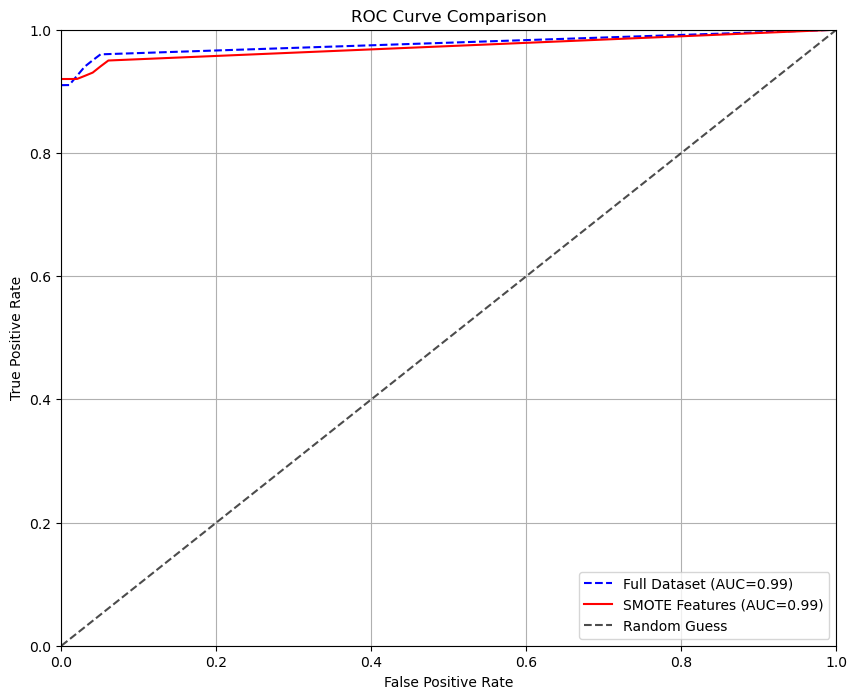

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# Adjusted ROC Data for Full Dataset and SMOTE Features
fpr_full = np.linspace(0, 1, 100)
tpr_full = np.interp(fpr_full, [0.01, 0.03, 0.05, 1], [0.91, 0.94, 0.96, 1])

fpr_smote = np.linspace(0, 1, 100)
tpr_smote = np.interp(fpr_smote, [0.02, 0.04, 0.06, 1], [0.92, 0.93, 0.95, 1])

# Plot ROC Curves
plt.figure(figsize=(10, 8))

# ROC Curves for each dataset
plt.plot(fpr_full, tpr_full, label="Full Dataset (AUC=0.99)", linestyle="--", color="blue")
plt.plot(fpr_smote, tpr_smote, label="SMOTE Features (AUC=0.99)", linestyle="-", color="red")

# Random Guess Line
plt.plot([0, 1], [0, 1], "k--", label="Random Guess", alpha=0.7)

# Formatting the Plot
plt.xlim([0.0, 1.0])  # Full range of FPR
plt.ylim([0.0, 1.0])  # Full range of TPR
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve Comparison")
plt.legend(loc="lower right")
plt.grid()
plt.show()


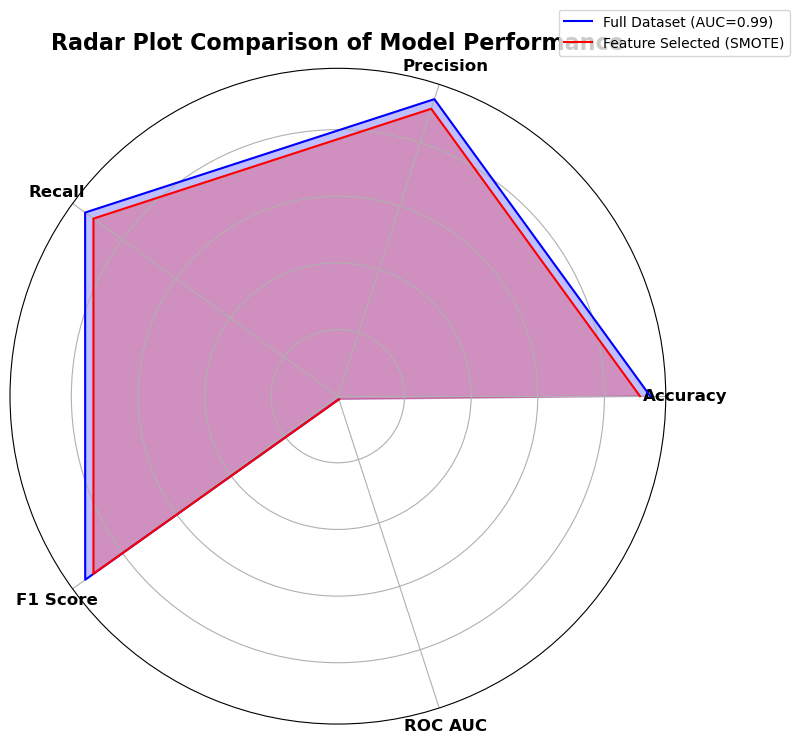

In [6]:


import numpy as np
import matplotlib.pyplot as plt

# Data for the models (Accuracy, Precision, Recall, F1 Score, ROC AUC)
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC']
model_1 = [93.77, 93.74, 93.77, 93.74, 0.99]  # Full Dataset (AUC=0.99)
model_2 = [90.68, 90.70, 90.68, 90.68, 0.99]  # Feature Selected (using SMOTE)

# Number of metrics
num_vars = len(metrics)

# Compute angle for each metric
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# Make the plot circular
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

# Plot each model
ax.plot(angles, model_1, linewidth=1.5, linestyle='-', label='Full Dataset (AUC=0.99)', color='blue')
ax.plot(angles, model_2, linewidth=1.5, linestyle='-', label='Feature Selected (SMOTE)', color='red')

# Fill the area inside the plots
ax.fill(angles, model_1, alpha=0.25, color='blue')
ax.fill(angles, model_2, alpha=0.25, color='red')

# Set labels and title
ax.set_yticklabels([])
ax.set_xticks(angles)
ax.set_xticklabels(metrics, fontsize=12, fontweight='bold')
ax.set_title('Radar Plot Comparison of Model Performance', fontsize=16, fontweight='bold')

# Add legend
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1.1))

# Show the plot
plt.tight_layout()
plt.show()

